## CPTS 580 Computer Vision, Final Project

## Super Resolution U-GAN

Colin Greeley

In [1]:
import tensorflow as tf
import tensorflow.keras.backend as K
from tensorflow.keras.applications import VGG19
from tensorflow.keras.applications.vgg19 import preprocess_input as vgg19_preprocess
from tensorflow.keras import layers, Model, optimizers, losses, models, activations
from tensorflow.keras.optimizers.schedules import PiecewiseConstantDecay
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import tensorflow_addons as tfa
import cv2
import os
import gc

physical_devices = tf.config.experimental.list_physical_devices('GPU')
for device in physical_devices:
    tf.config.experimental.set_memory_growth(device, True)


## Data Methods

In [2]:

instance_num = 5  # number of images from each of the 1000 classes (as much as can fit in memory)

def get_training_data():
    dir = "C:/Users/Greeley/python/Data/ImageNet/download/train"
    images = np.zeros((instance_num*1000,256,256,3), dtype="uint8")
    labels = np.zeros((instance_num*1000,), dtype="uint32")
    min_size = 256
    for i, im_dir in enumerate(os.listdir(dir)):
        class_dir = os.path.join(dir, im_dir)
        j = 0
        for im in os.listdir(class_dir):
            if j >= instance_num:
                break
            new_im = cv2.imread(os.path.join(class_dir, im))[:,:,::-1]
            if new_im.shape[1] > min_size and new_im.shape[0] > min_size:
                images[i*instance_num + j] = tf.image.resize(new_im, (min_size, min_size), antialias=True)
                labels[i*instance_num + j] = i
                j += 1
    print("Images:", len(images))
    return images, labels

def get_validation_data(k=None, size=256, seed=None):
    dir = "C:/Users/Greeley/python/Data/ImageNet/download/val"
    if seed is not None:
        np.random.seed(seed)
    min_size = 64
    images = []
    j = 0
    dir_list = os.listdir(dir)
    if k == None:
        k = len(dir_list)
    for im in dir_list:
        if np.random.random() < k/len(dir_list):
            #new_im = cv2.imread(os.path.join(dir, im))[:,:,::-1]
            new_im = Image.open(os.path.join(dir, im))
            x_diff = int((new_im.size[1] // 8) * 8)
            y_diff = int((new_im.size[0] // 8) * 8)
            if x_diff > min_size and y_diff > min_size:
                #images.append(cv2.resize(new_im, (size, size)))
                images.append(np.asarray(new_im.resize((size, size), resample=Image.Resampling.BICUBIC).convert("RGB")))
    images = np.asarray(images).astype("uint8")
    print("Images:", images.shape)
    return images

In [3]:

class SRU_GAN:
    
    def __init__(self, batch_size) -> None:
        self.batch_size = batch_size
        self.g_optimizer = optimizers.Adam(PiecewiseConstantDecay(boundaries=[200_000], values=[1e-4, 1e-5]))
        self.d_optimizer = optimizers.Adam(PiecewiseConstantDecay(boundaries=[200_000], values=[1e-4, 1e-5]))
        vgg = VGG19(input_shape=(None, None, 3), include_top=False)
        self.vgg = Model(vgg.input, vgg.layers[20].output)
        self.generator = self.make_generator()
        self.discriminator = self.make_discriminator()
        
    def normalize_01(self, x):
        """Normalizes RGB images to [0, 1]."""
        return x / 255.0

    def normalize_m11(self, x):
        """Normalizes RGB images to [-1, 1]."""
        return x / 127.5 - 1
    
    def denormalize_m11(self, x):
        """Inverse of normalize_m11."""
        return (x + 1) * 127.5

    def load(self):
        im = np.zeros((1, 256, 256, 3))
        self.generator(im)
        self.generator.load_weights("Generator_weights.h5")
        self.discriminator(im)
        self.discriminator.load_weights("Discriminator_weights.h5")
        
    def AttentionModule(self, name="AttentionModule"):
        """Attention module"""
        def channel_attention(x):
            squeeze = layers.Dense(x.shape[-1]//8)
            excitation = layers.Dense(x.shape[-1])
            av_pool = layers.GlobalAveragePooling2D()(x)
            mx_pool = layers.GlobalMaxPooling2D()(x)
            av_sq = squeeze(av_pool)
            av_sq = layers.Activation("swish")(av_sq)
            mx_sq = squeeze(mx_pool)
            mx_sq = layers.Activation("swish")(mx_sq)
            av_ex = excitation(av_sq)
            mx_ex = excitation(mx_sq)
            pool = layers.Add()([av_ex, mx_ex])
            attention_scores = layers.Activation("sigmoid")(pool)
            attention_scores = layers.Reshape((1,1,x.shape[-1]))(attention_scores)
            return layers.multiply([x, attention_scores])
        def spatial_attention(x):
            avg_pool = layers.Lambda(lambda x: K.mean(x, axis=3, keepdims=True))(x)
            max_pool = layers.Lambda(lambda x: K.max(x, axis=3, keepdims=True))(x)
            feature_map = layers.Concatenate(axis=3)([avg_pool, max_pool])
            attention_scores = layers.Conv2D(filters=1, kernel_size=7, padding='same', activation='sigmoid', use_bias=False)(feature_map)
            return layers.multiply([x, attention_scores])
        def attention_module(x_in):
            x = channel_attention(x_in)
            x = spatial_attention(x)
            return x
        return attention_module
    
    def DenseBlock(self, width):
        def apply(x):
            if x.shape[-1] != width:
                residual = layers.Conv2D(width, kernel_size=1)(x)
            else:
                residual = x
            x1 = layers.Conv2D(width, kernel_size=3, padding="same", activation="swish")(x)
            x1 = layers.Concatenate()([residual, x1])
            x2 = layers.Conv2D(width, kernel_size=3, padding="same", activation="swish")(x1)
            x2 = layers.Concatenate()([x1, x2])
            x3 = layers.Conv2D(width, kernel_size=3, padding="same", activation="swish")(x2)
            x = layers.Add()([residual, x3])
            return x
        return apply

    def ResBlock(self, width):
        def apply(x):
            if x.shape[-1] != width:
                residual = layers.Conv2D(width, kernel_size=1)(x)
            else:
                residual = x
            x = layers.Conv2D(width, kernel_size=3, padding="same", activation="swish")(x)
            x = layers.Conv2D(width, kernel_size=3, padding="same", activation="swish")(x)
            x = layers.Add()([residual, x])
            return x
        return apply

    def make_generator(self):
        
        res = []
        res_depth = 2
        x_in = layers.Input((None, None, 3))            # x
        x = layers.Lambda(self.normalize_01)(x_in)
        x = layers.Conv2D(64, 1, padding="same", activation="swish")(x)
        x = self.ResBlock(64)(x)
        res.append(x)
        x = layers.MaxPooling2D()(x)                    # x/2
        for _ in range(res_depth):
            x = self.ResBlock(96)(x)
        res.append(x)
        x = layers.MaxPooling2D()(x)                    # x/4
        for _ in range(res_depth):
            x = self.ResBlock(128)(x)
        res.append(x)
        x = layers.MaxPooling2D()(x)                    # x/8
        for _ in range(res_depth):
            x = self.ResBlock(256)(x)
        x = layers.Conv2D(512, kernel_size=1, activation="swish")(x)
        x = self.AttentionModule()(x)
        x = tf.nn.depth_to_space(x, block_size=2)       # x/4
        x = layers.Concatenate()([x, res.pop()]) 
        for _ in range(res_depth):
            x = self.ResBlock(128)(x)
        x = layers.Conv2D(384, kernel_size=1, activation="swish")(x)
        x = self.AttentionModule()(x)
        x = tf.nn.depth_to_space(x, block_size=2)       # x/2
        x = layers.Concatenate()([x, res.pop()]) 
        for _ in range(res_depth):
            x = self.ResBlock(96)(x)
        x = layers.Conv2D(256, kernel_size=1, activation="swish")(x)
        x = self.AttentionModule()(x)
        x = tf.nn.depth_to_space(x, block_size=2)       # x
        x = layers.Concatenate()([x, res.pop()])  
        for _ in range(8):
            x = self.DenseBlock(96)(x)
        for _ in range(8):
            x = self.DenseBlock(64)(x)
            
        x = layers.Conv2D(256, kernel_size=3, padding='same', activation="swish")(x)
        x = self.AttentionModule()(x)
        x = tf.nn.depth_to_space(x, block_size=2)       # 2x
        x = self.ResBlock(64)(x)
        
        x = layers.Conv2D(3, 1, activation="tanh", padding="same")(x)
        x = layers.Lambda(self.denormalize_m11)(x)
        generator = Model(x_in, x)
        generator.summary()
        return generator
        
    def make_discriminator(self):
        att_blocks = 0
        widths = [64, 64, 128, 256, 512, 512]
        block_depth = 1
        skips = []
        
        x_in = layers.Input((None, None, 3))
        x = layers.Lambda(self.normalize_m11)(x_in)
        x = layers.Conv2D(widths[0], kernel_size=3, padding="same")(x)
        x = layers.LeakyReLU(alpha=0.2)(x)
        for width in widths:
            residual = layers.Conv2D(width, kernel_size=1)(x)
            x = layers.Conv2D(width, kernel_size=3, padding='same')(x)
            x = layers.LeakyReLU(alpha=0.2)(x)
            x = layers.Conv2D(width, kernel_size=3, padding='same')(x)
            x = layers.LeakyReLU(alpha=0.2)(x)
            x = layers.Add()([x, residual])
            x = layers.AveragePooling2D()(x)
        x = layers.Conv2D(widths[-1]*2, kernel_size=3, padding='same')(x)
        x = layers.LeakyReLU(alpha=0.2)(x)
        x = layers.GlobalAveragePooling2D()(x)
        x = layers.Dense(1024)(x)
        x = layers.LeakyReLU(alpha=0.2)(x)
        validity = layers.Dense(1, activation="sigmoid")(x)
        label = layers.Dense(1000, activation="softmax", name="label")(x)
        discriminator = Model(x_in, [validity, label], name='Discriminator')
        #discriminator.summary()
        return discriminator
        
    def train_generator(self):
        interps = [cv2.INTER_AREA, cv2.INTER_CUBIC, cv2.INTER_LINEAR, cv2.INTER_NEAREST, cv2.INTER_LANCZOS4]
        while True:
            idxs = np.random.choice(len(self.images), self.batch_size)
            Y = np.array(self.images [idxs])
            labels = np.array(self.labels [idxs])
            X = np.array([cv2.resize(y, (y.shape[1]//2, y.shape[0]//2), interpolation=interps[np.random.randint(len(interps))]) for y in Y])
            yield tf.constant(X), [tf.constant(Y), tf.constant(labels)]
            #yield X, [Y, labels]
    
    #@tf.function
    def update(self, X, Y):
        with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
            x = tf.cast(X, tf.float32)
            y = tf.cast(Y[0], tf.float32)
            labels = tf.cast(Y[1], tf.float32)
            gen_image = self.generator(x, training=True)
            hr_output, pred_hr_label = self.discriminator(y, training=True)
            sr_output, pred_sr_label = self.discriminator(gen_image, training=True)
            hr = vgg19_preprocess(y)
            sr = vgg19_preprocess(gen_image)
            sr_features = self.vgg(sr) / 12.75
            hr_features = self.vgg(hr) / 12.75
            con_loss = losses.MeanSquaredError()(hr_features, sr_features) + losses.MeanSquaredError()(y/127.5-1, gen_image/127.5-1)
            gen_loss = 1e-3 * losses.BinaryCrossentropy()(tf.ones_like(sr_output), sr_output) #+ 1e-3 * losses.SparseCategoricalCrossentropy()(labels, pred_sr_label)
            perc_loss = con_loss + gen_loss
            validity_loss = losses.BinaryCrossentropy()(tf.ones_like(hr_output), hr_output) + losses.BinaryCrossentropy()(tf.zeros_like(sr_output), sr_output)
            class_loss = losses.SparseCategoricalCrossentropy()(labels, pred_hr_label) + losses.SparseCategoricalCrossentropy()(labels, pred_sr_label)
            disc_loss = [validity_loss, class_loss]
        gradients_of_generator = gen_tape.gradient(perc_loss, self.generator.trainable_variables)
        gradients_of_discriminator = disc_tape.gradient(disc_loss, self.discriminator.trainable_variables)
        self.g_optimizer.apply_gradients(zip(gradients_of_generator, self.generator.trainable_variables))
        self.d_optimizer.apply_gradients(zip(gradients_of_discriminator, self.discriminator.trainable_variables))
        return (validity_loss, class_loss, gen_loss, con_loss)
    
    def train(self, images, labels):
        self.images = images
        self.labels = labels
        self.step = 0
        train_gen = self.train_generator()
        while self.step < 400_000:
            x, y = next(train_gen)
            validity_loss, class_loss, gen_loss, con_loss = self.update(x, y)
            tf.keras.backend.clear_session()
            gc.collect()
            if self.step % 100 == 0:
                print ("%d [D loss: %f; L loss: %f] [G loss: %f; C loss: %f]" % (self.step, validity_loss, class_loss, gen_loss, con_loss))
                plt.figure()
                plt.subplot(1,2,1)
                plt.imshow(np.clip(self.generator(x)[0] / 255., 0, 1))
                plt.subplot(1,2,2)
                plt.imshow(np.asarray(y[0][0]) / 255.)
                #plt.savefig("figures/" + str(self.step) + ".png")
                plt.show()
                plt.close()
                self.generator.save_weights("Generator_weights.h5")
                self.discriminator.save_weights("Discriminator_weights.h5")
            self.step += 1
                

## Model Training

Images: 5000
Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 lambda (Lambda)                (None, None, None,   0           ['input_2[0][0]']                
                                3)                                                                
                                                                                                  
 conv2d (Conv2D)                (None, None, None,   256         ['lambda[0][0]']                 
                                64)                                            

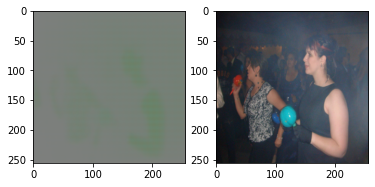

100 [D loss: 1.520736; L loss: 13.517794] [G loss: 0.000549; C loss: 0.205073]


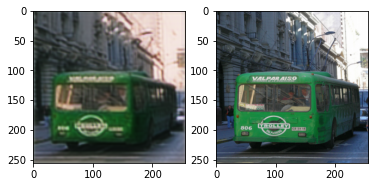

200 [D loss: 1.373160; L loss: 13.834333] [G loss: 0.000578; C loss: 0.112708]


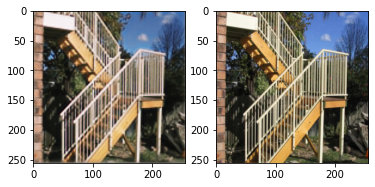

300 [D loss: 1.371285; L loss: 13.901735] [G loss: 0.000699; C loss: 0.079404]


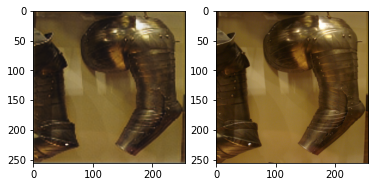

KeyboardInterrupt: 

In [4]:

batch_size = 3 # as much as can fit in GPU memory
images, labels = get_training_data()
classifier = SRU_GAN(batch_size=batch_size)
#classifier.load() # if training needs to be stopped, models are saved and training can resume
classifier.train(images, labels)

## Get Validation Data

In [6]:
del images
del labels
images = get_validation_data(10)

Images: (9, 256, 256, 3)


In [7]:

batch_size = 6
classifier = SRU_GAN(batch_size=batch_size)
classifier.load()


Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 lambda_11 (Lambda)             (None, None, None,   0           ['input_5[0][0]']                
                                3)                                                                
                                                                                                  
 conv2d_109 (Conv2D)            (None, None, None,   256         ['lambda_11[0][0]']              
                                64)                                                         

## FID Score

In [11]:

from tensorflow.keras.applications import InceptionV3
from scipy import linalg
model = InceptionV3()
model = InceptionV3(include_top=False, pooling='avg', input_shape=(299,299,3))

def calculate_fid(model, images1, images2):
    # calculate activations
    act1 = model(images1).numpy()
    act2 = model(images2).numpy()
    # calculate mean and covariance statistics
    mu1, sigma1 = act1.mean(axis=0), np.cov(act1, rowvar=False)
    mu2, sigma2 = act2.mean(axis=0), np.cov(act2, rowvar=False)
    # calculate sum squared difference between means
    ssdiff = np.sum((mu1 - mu2)**2.0)
    # calculate sqrt of product between cov
    covmean = linalg.sqrtm(sigma1.dot(sigma2))
    # check and correct imaginary numbers from sqrt
    if np.iscomplexobj(covmean):
        covmean = covmean.real
        # calculate score
    fid = ssdiff + np.trace(sigma1 + sigma2 - 2.0 * covmean)
    return fid



dir = "C:/Users/Greeley/python/Data/ImageNet/download/val"
dir_list = os.listdir(dir)
HR_fid = 0
SR_fid = 0
bc_fid = 0
bl_fid = 0
nn_fid = 0 
batch_size = 20
images = get_validation_data(50_000, 299)
for i in range(0, len(images), batch_size):
    HR_images = images[i:i+batch_size]
    LR_images = np.asarray([np.asarray(Image.fromarray(im).resize((299//2, 299//2), resample=Image.Resampling.BICUBIC).convert("RGB")) for im in HR_images])
    x_diff = int((LR_images[0].shape[1] // 8) * 8) + 8
    y_diff = int((LR_images[0].shape[0] // 8) * 8) + 8
    LR_images = np.asarray([np.asarray(Image.fromarray(im).resize((x_diff, y_diff), resample=Image.Resampling.BICUBIC).convert("RGB")) for im in HR_images])
    SR_images = classifier.generator(tf.constant(LR_images)).numpy().astype("uint8")
    SR_images = np.asarray([np.asarray(Image.fromarray(im).resize((299, 299), resample=Image.Resampling.BICUBIC).convert("RGB")) for im in SR_images])
    bc_images = np.asarray([np.asarray(Image.fromarray(im).resize((299, 299), resample=Image.Resampling.BICUBIC).convert("RGB")) for im in LR_images])
    bl_images = np.asarray([np.asarray(Image.fromarray(im).resize((299, 299), resample=Image.Resampling.BILINEAR).convert("RGB")) for im in LR_images])
    nn_images = np.asarray([np.asarray(Image.fromarray(im).resize((299, 299), resample=Image.Resampling.NEAREST).convert("RGB")) for im in LR_images])
    HR_images = HR_images.astype("float64") / 255.
    LR_images = LR_images.astype("float64") / 255.
    SR_images = SR_images.astype("float64") / 255.
    bc_images = bc_images.astype("float64") / 255.
    bl_images = bl_images.astype("float64") / 255.
    nn_images = nn_images.astype("float64") / 255.
    HR_fid += calculate_fid(model, HR_images, HR_images)
    SR_fid += calculate_fid(model, HR_images, SR_images)
    bc_fid += calculate_fid(model, HR_images, bc_images)
    bl_fid += calculate_fid(model, HR_images, bl_images)
    nn_fid += calculate_fid(model, HR_images, nn_images)
HR_fid /= len(images)/batch_size
SR_fid /= len(images)/batch_size
bc_fid /= len(images)/batch_size
bl_fid /= len(images)/batch_size
nn_fid /= len(images)/batch_size
print('FID (High Resolution Images): %.3f' % HR_fid)
print('FID (Predicted Images): %.3f' % SR_fid)
print('FID (Bicubic Upsampled Images): %.3f' % bc_fid)
print('FID (Bilinear Upsampled Images): %.3f' % bl_fid)
print('FID (Nearest-Neighbor Upsampled Images): %.3f' % nn_fid)

Images: (2073, 299, 299, 3)
FID (High Resolution Images): -0.000
FID (Predicted Images): 22.123
FID (Bicubic Upsampled Images): 63.162
FID (Bilinear Upsampled Images): 71.617
FID (Nearest-Neighbor Upsampled Images): 67.618


## Image Samples for 2x super sampling

Images: (4, 256, 256, 3)


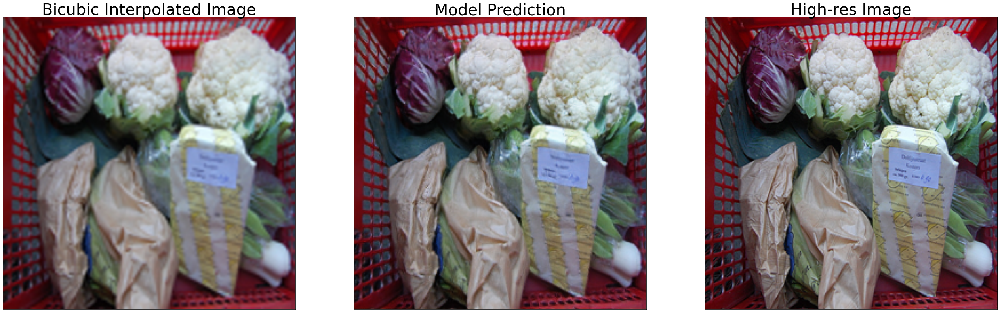

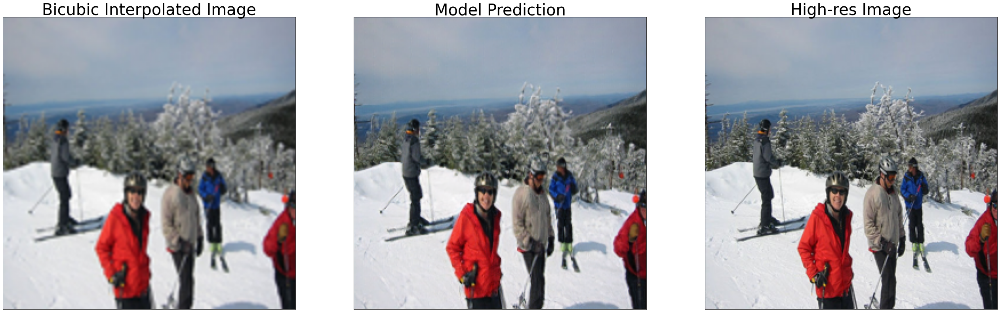

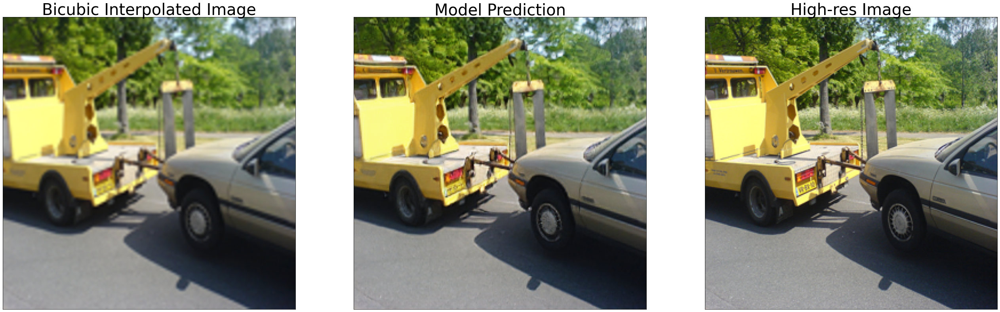

In [12]:


dir = "C:/Users/Greeley/python/Data/ImageNet/download/val"
dir_list = os.listdir(dir)
images = get_validation_data(5, 256, seed=2)
HR_images = images
LR_images = np.asarray([np.asarray(Image.fromarray(im).resize((256//2, 256//2), resample=Image.Resampling.BICUBIC).convert("RGB")) for im in HR_images])
SR_images = classifier.generator(tf.constant(LR_images)).numpy().astype("uint8")
FR_images = np.asarray([np.asarray(Image.fromarray(im).resize((256, 256), resample=Image.Resampling.BICUBIC).convert("RGB")) for im in LR_images])

for i in range(3):
    fig = plt.figure(figsize=(45,15))
    ax1 = fig.add_subplot(131)
    ax2 = fig.add_subplot(132)
    ax3 = fig.add_subplot(133)
    ax1.title.set_text('Bicubic Interpolated Image')
    ax1.title.set_size(40)
    ax2.title.set_text('Model Prediction')
    ax2.title.set_size(40)
    ax3.title.set_text('High-res Image')
    ax3.title.set_size(40)
    ax1.tick_params(left=False, right=False, labelleft=False, labelbottom=False, bottom=False)
    ax2.tick_params(left=False, right=False, labelleft=False, labelbottom=False, bottom=False)
    ax3.tick_params(left=False, right=False, labelleft=False, labelbottom=False, bottom=False)
    plt.subplot(1,3,1)
    plt.imshow(FR_images[i] / 255.)
    plt.subplot(1,3,2)
    plt.imshow(SR_images[i] / 255.)
    plt.subplot(1,3,3)
    plt.imshow(HR_images[i] / 255.)  
    plt.savefig("./images/sample2x_{}.png".format(i+1))
    #plt.clf()


## Image Samples for 4x super sampling

Images: (4, 256, 256, 3)


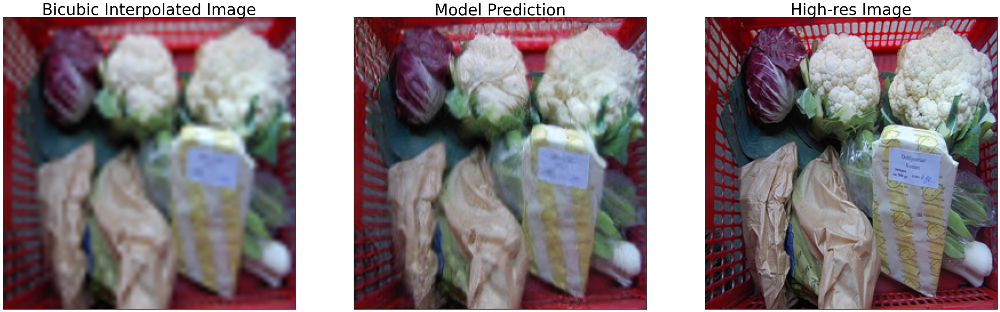

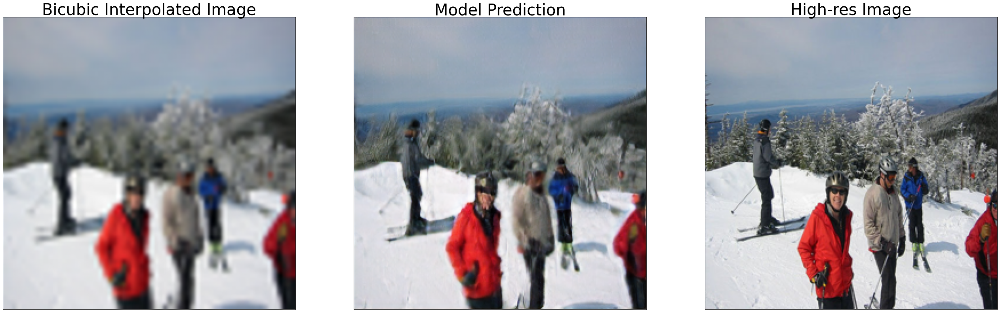

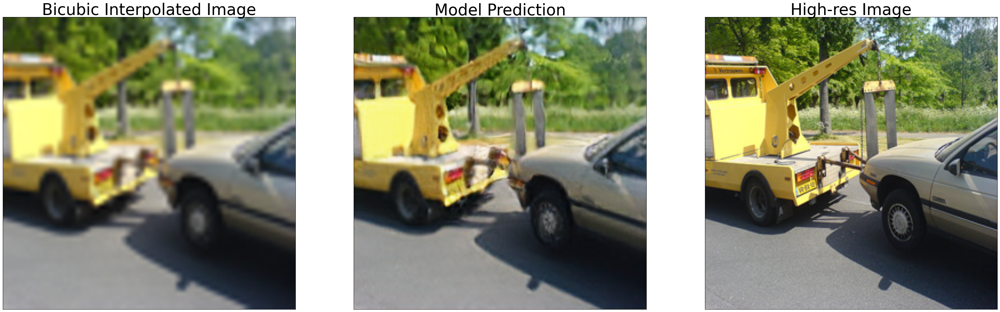

In [13]:

dir = "C:/Users/Greeley/python/Data/ImageNet/download/val"
dir_list = os.listdir(dir)
images = get_validation_data(5, 256, seed=2)
HR_images = images
LR_images = np.asarray([np.asarray(Image.fromarray(im).resize((256//4, 256//4), resample=Image.Resampling.BICUBIC).convert("RGB")) for im in HR_images])
SR_images = classifier.generator(tf.constant(LR_images)).numpy()
SR_images = classifier.generator(tf.constant(SR_images)).numpy().astype("uint8")
FR_images = np.asarray([np.asarray(Image.fromarray(im).resize((256, 256), resample=Image.Resampling.BICUBIC).convert("RGB")) for im in LR_images])

for i in range(3):
    fig = plt.figure(figsize=(45,15))
    ax1 = fig.add_subplot(131)
    ax2 = fig.add_subplot(132)
    ax3 = fig.add_subplot(133)
    ax1.title.set_text('Bicubic Interpolated Image')
    ax1.title.set_size(40)
    ax2.title.set_text('Model Prediction')
    ax2.title.set_size(40)
    ax3.title.set_text('High-res Image')
    ax3.title.set_size(40)
    ax1.tick_params(left=False, right=False, labelleft=False, labelbottom=False, bottom=False)
    ax2.tick_params(left=False, right=False, labelleft=False, labelbottom=False, bottom=False)
    ax3.tick_params(left=False, right=False, labelleft=False, labelbottom=False, bottom=False)
    plt.subplot(1,3,1)
    plt.imshow(FR_images[i] / 255.)
    plt.subplot(1,3,2)
    plt.imshow(SR_images[i] / 255.)
    plt.subplot(1,3,3)
    plt.imshow(HR_images[i] / 255.)  
    plt.savefig("./images/sample4x_{}.png".format(i+1))
    #plt.clf()

## Image Super Resolution

Images: (4, 256, 256, 3)


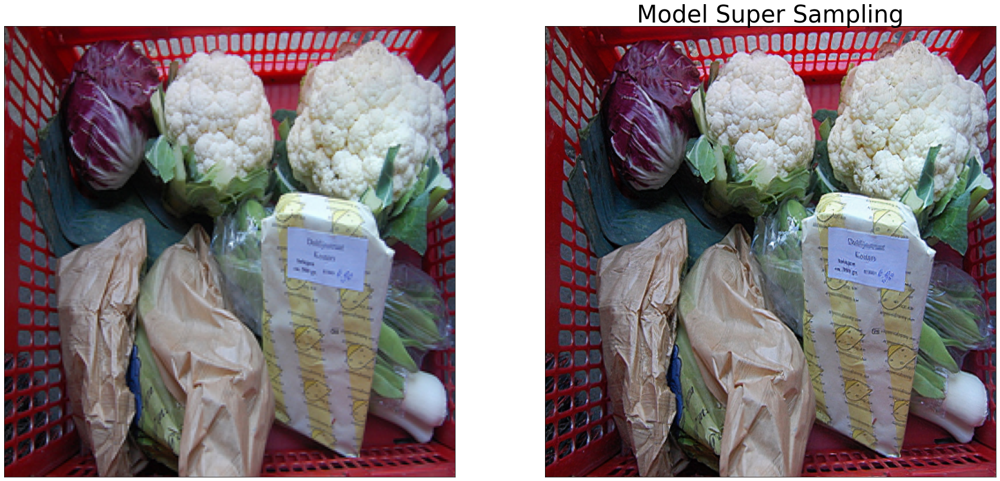

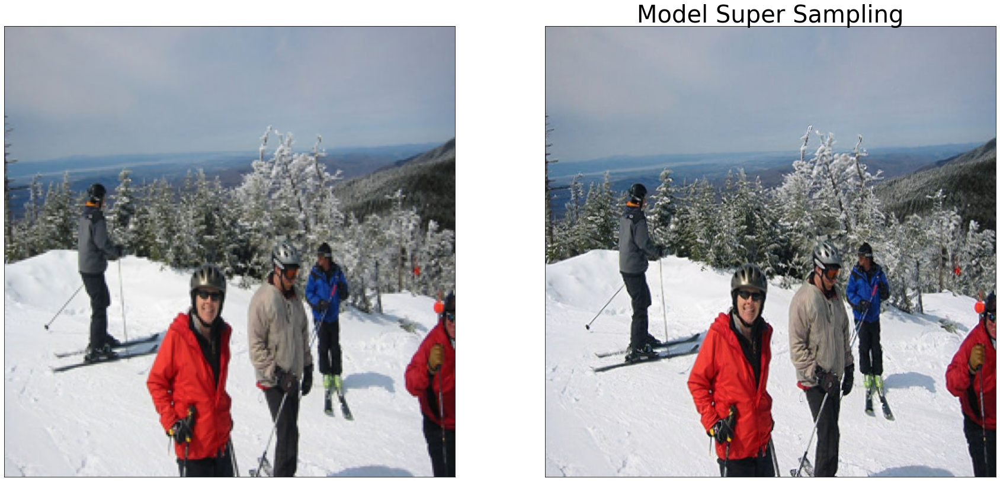

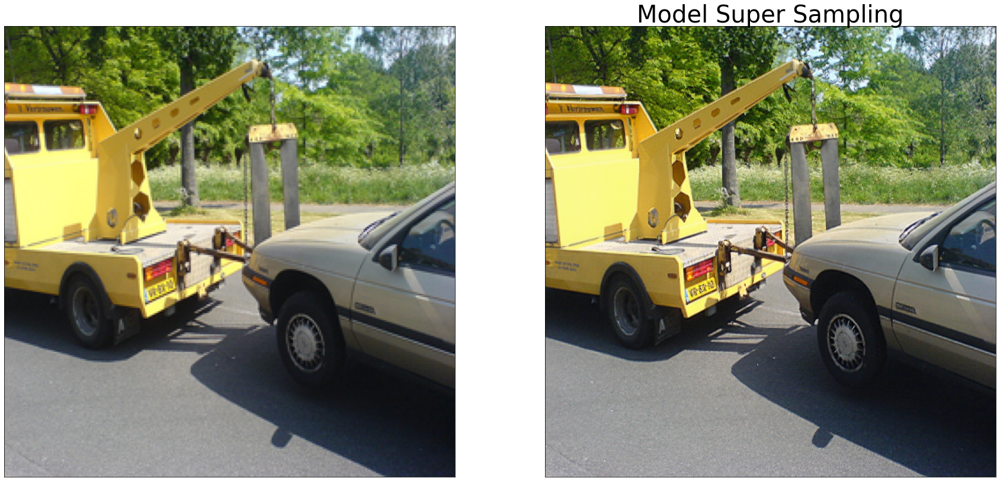

In [14]:
dir = "C:/Users/Greeley/python/Data/ImageNet/download/val"
dir_list = os.listdir(dir)
images = get_validation_data(5, 256, seed=2)
HR_images = images
SR_images = classifier.generator(tf.constant(HR_images)).numpy().astype("uint8")
for i in range(3):
    fig = plt.figure(figsize=(30,15))
    ax1 = fig.add_subplot(121)
    ax2 = fig.add_subplot(122)
    ax2.title.set_text('Model Super Sampling')
    ax2.title.set_size(40)
    ax3.title.set_text('High-res Image')
    ax3.title.set_size(40)
    ax1.tick_params(left=False, right=False, labelleft=False, labelbottom=False, bottom=False)
    ax2.tick_params(left=False, right=False, labelleft=False, labelbottom=False, bottom=False)
    plt.subplot(1,2,1)
    plt.imshow(HR_images[i] / 255.)
    plt.subplot(1,2,2)
    plt.imshow(SR_images[i] / 255.)
    plt.savefig("./images/super_sample_{}.png".format(i+1))
    #plt.clf()